# SKW YOLO26 Detection Training

Train a YOLO26 model on the SKW drone dataset using fastai.

- 434 images (792x792) with 2 classes: `skw_0S` and `skw_1R`
- Pretrained COCO weights with partial matching (nc=80 -> nc=2)
- Variable resolution training + geometric bbox augmentations
- ultralytics E2ELoss bridged to fastai Learner

In [1]:
import sys
from pathlib import Path

import torch
from fastai.vision.all import *
from safetensors.torch import save_file

sys.path.insert(0, str(Path.cwd().parent))
sys.path.insert(0, str(Path.cwd()))

In [2]:
from dataset import build_dataloaders, get_class_info
from model import YOLO26ForFastai
from loss import (
    YOLO26Loss,
    E2ELossDecayCallback,
    DetectionGradientAccumulation,
    EMACallback,
)
from metrics import YOLOmAP50, RasterIoU
from augs import GeometricBBoxAugCallback, MosaicCallback
from helpers import plot_detection_batch, plot_channel_histograms

from shared.augs import (
    RandomRectangle,
    RandomSharpenBlur,
    ImageAugmentationCallback,
    DynamicMinMaxNormalize,
)
from shared.data import parse_splits
from shared.helpers import print_system_info

In [3]:
print_system_info()

System Information
-----------------------------------
PyTorch Version : 2.10.0+cu128
CUDA Available  : Yes
CUDA Version    : 12.8
Python Version  : 3.13.7
Fastai Version  : 2.8.7
Default Device  : cuda:0
Device Name     : NVIDIA GeForce RTX 4090
-----------------------------------


In [4]:
# Configuration
model_size = "m"  # nano, small, medium, large, xlarge
model_version = f"SKW_YOLO26_{model_size}"
#########################
use_bf16 = True
single_class = True  # True = remap all classes to one class
#########################
img_size = 800  # must be divisible by 32 (YOLO stride); 792 -> 800
#########################
batch_size = 6
gradient_accumulation_batch_size = 16
learning_rate = 0.001
epoch_count = 20
#########################
data_dir = Path("/media/nick/4TB Working 7/Datasets/SKW")
#########################
CLASS_NAMES, NUM_CLASSES = get_class_info(single_class)
print(f"Classes ({NUM_CLASSES}): {CLASS_NAMES}")
assert data_dir.exists(), f"Dataset not found: {data_dir}"

Classes (1): {0: 'skw'}


In [5]:
from collections import Counter

split_map = parse_splits(data_dir)
counts = Counter(split_map.values())
print(
    f"Train: {counts.get('train', 0)}, Val: {counts.get('val', 0)}, Test: {counts.get('test', 0)}"
)
print(f"Total: {sum(counts.values())}")

Train: 387, Val: 45, Test: 2
Total: 434


In [6]:
dls = build_dataloaders(
    data_dir=data_dir,
    img_size=img_size,
    bs=batch_size,
    num_workers=8,
    single_class=single_class,
)

Train images: 389, Val images: 45


In [7]:
# Inspect a training batch
batch = next(iter(dls.train))
images, targets = batch
print(f"Image shape: {images.shape}")
print(f"Total boxes in batch: {len(targets['batch_idx'])}")
print(f"Classes in batch: {targets['cls'].unique().tolist()}")
print(f"Image dtype: {images.dtype}")
print(f"Image range: [{images.min().item():.3f}, {images.max().item():.3f}]")

Image shape: torch.Size([6, 3, 800, 800])
Total boxes in batch: 32
Classes in batch: [0.0]
Image dtype: torch.float32
Image range: [0.000, 1.000]


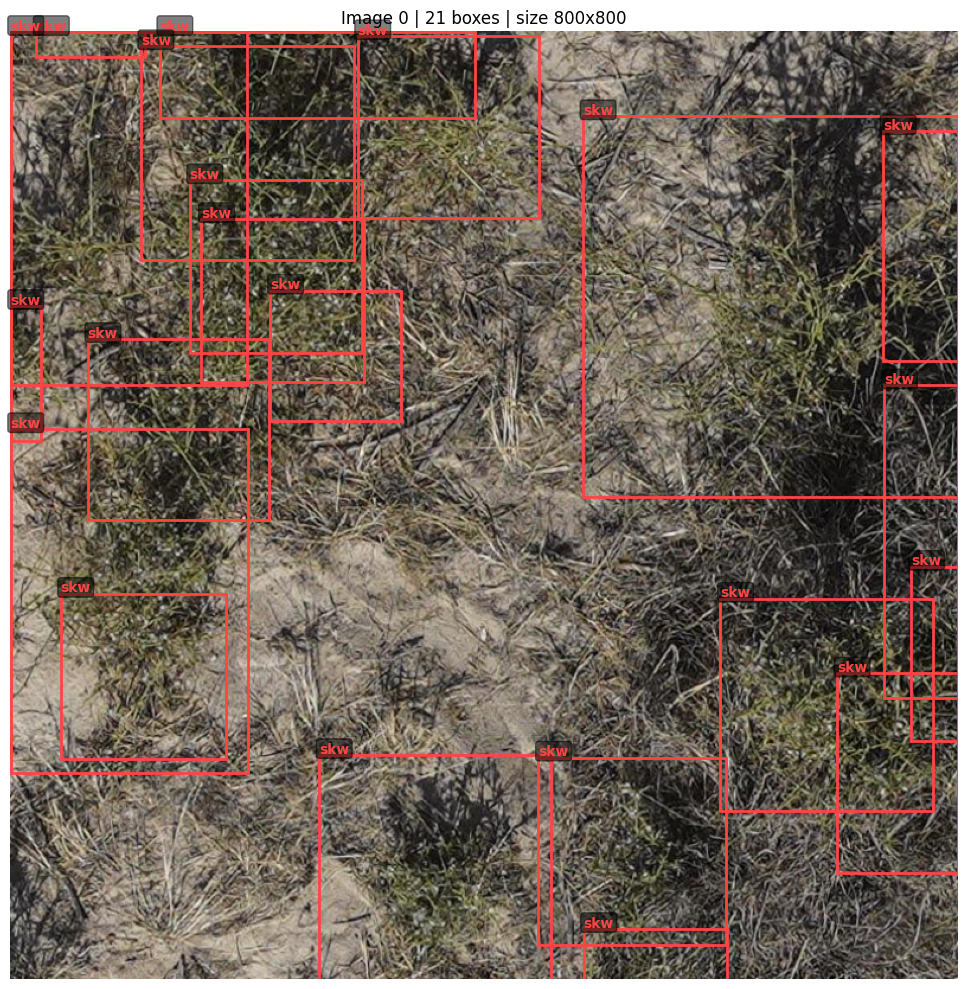

Image shape: torch.Size([6, 3, 800, 800])
Total boxes in batch: 32
Boxes in this image: 21


In [8]:
plot_detection_batch(batch, image_idx=0, class_names=CLASS_NAMES)

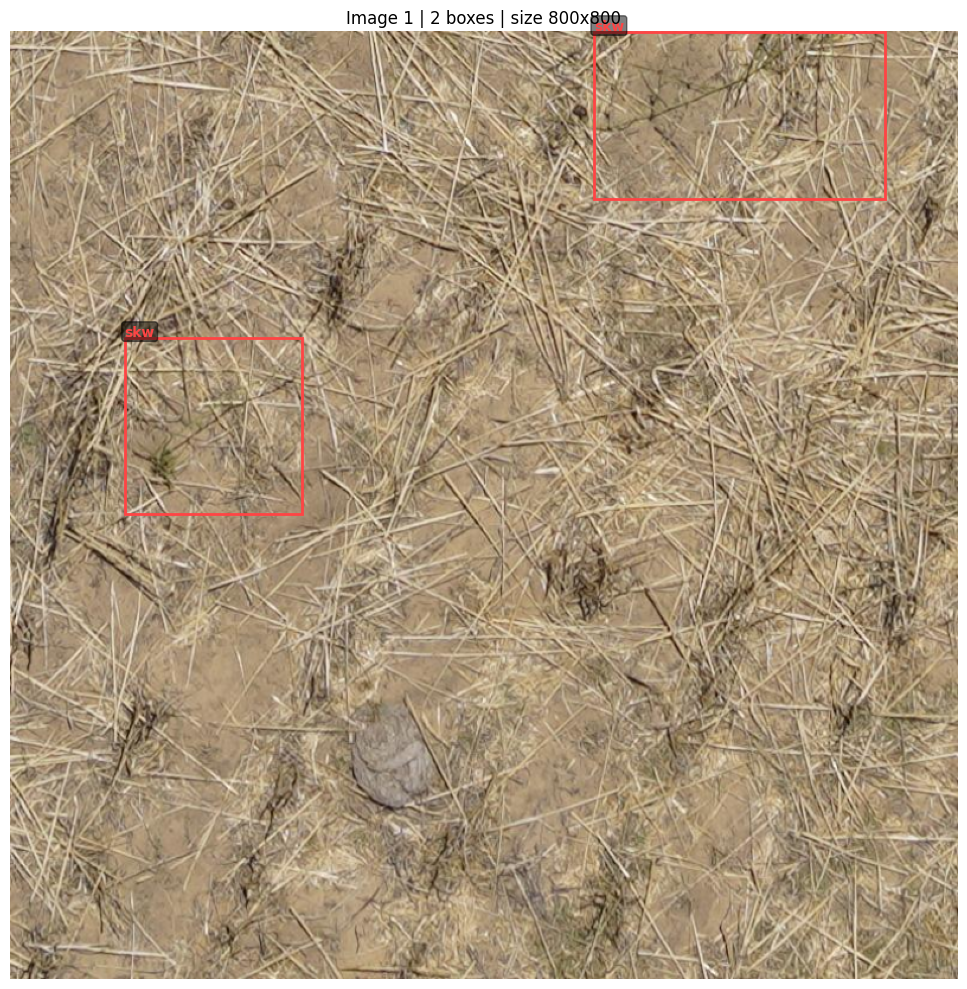

Image shape: torch.Size([6, 3, 800, 800])
Total boxes in batch: 32
Boxes in this image: 2


In [9]:
plot_detection_batch(batch, image_idx=1, class_names=CLASS_NAMES)

In [10]:
model = YOLO26ForFastai(
    model_size=model_size,
    nc=NUM_CLASSES,
    pretrained=True,
    epochs=epoch_count,
)

Overriding model.yaml nc=80 with nc=1
Loaded 756/768 pretrained weights


In [11]:
# Verify forward pass
model.train()
dummy = torch.randn(2, 3, img_size, img_size)
train_out = model(dummy)
print(f"Training output keys: {list(train_out.keys())}")
print(f"one2many scores shape: {train_out['one2many']['scores'].shape}")
print(f"one2many boxes shape: {train_out['one2many']['boxes'].shape}")
print(f"Has gradient: {train_out['one2many']['boxes'].requires_grad}")

model.eval()
with torch.no_grad():
    eval_out = model(dummy)
print(f"\nEval decoded shape: {eval_out[0].shape}")
print("Eval decoded format: [x1, y1, x2, y2, conf, cls]")

Training output keys: ['one2many', 'one2one']
one2many scores shape: torch.Size([2, 1, 13125])
one2many boxes shape: torch.Size([2, 4, 13125])
Has gradient: True

Eval decoded shape: torch.Size([2, 300, 6])
Eval decoded format: [x1, y1, x2, y2, conf, cls]


In [12]:
# Verify loss computation
model.train()
loss_func = YOLO26Loss(model, pos_weight=6.0)

dummy_preds = model(dummy)
dummy_cls = torch.tensor([[0.0], [float(NUM_CLASSES - 1)], [0.0]])
dummy_targets = {
    "batch_idx": torch.tensor([0, 0, 1]),
    "cls": dummy_cls,
    "bboxes": torch.tensor(
        [[0.5, 0.5, 0.2, 0.3], [0.3, 0.7, 0.1, 0.1], [0.6, 0.4, 0.15, 0.25]]
    ),
}

loss = loss_func(dummy_preds, dummy_targets)
print(f"Loss: {loss.item():.4f}, requires_grad: {loss.requires_grad}")
loss.backward()
print("Backward pass OK")

Loss: 51.6524, requires_grad: True
Backward pass OK


In [13]:
# Image-only augmentations (applied via callback, don't affect bboxes)
image_augs = [
    # BatchResample(  # Variable resolution training
    #     min_scale=0.5, max_scale=1.2, plateau_min=0.7, plateau_max=1.0
    # ),
    RandomRectangle(p=0.3, sl=0.05, sh=0.4),
    RandomSharpenBlur(min_factor=0.5, max_factor=1.5),
    DynamicMinMaxNormalize(),
]

callbacks = [
    MosaicCallback(p=0.2),
    ImageAugmentationCallback(image_augs),
    GeometricBBoxAugCallback(flip_p=0.5, rot90_p=0.5),
    E2ELossDecayCallback(),
    EMACallback(decay=0.9999, tau=2000),
    ShowGraphCallback(),
    DetectionGradientAccumulation(gradient_accumulation_batch_size),
    # GradientClip(max_norm=10.0),
]

Post-aug image shape: torch.Size([6, 3, 800, 800])
Post-aug image range: [0.000, 1.000]


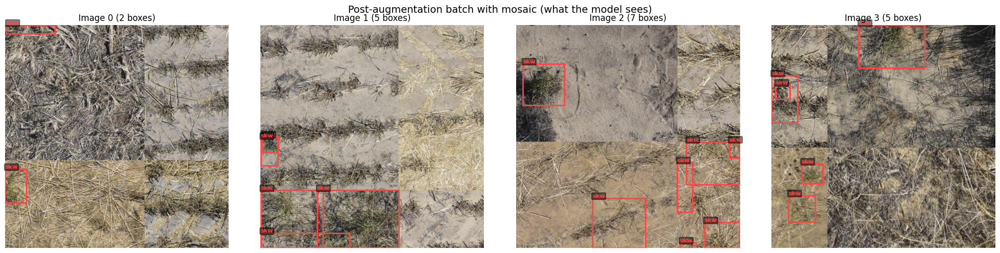

In [14]:
# Visualise post-augmentation batch with bounding boxes
import random
import matplotlib.patches as mpatches
from fastai.torch_core import TensorImage

# Grab 4 batches for mosaic (each image uses 1 from main + 3 from extras)
train_iter = iter(dls.train)
batches = [next(train_iter) for _ in range(4)]
main_images, main_targets = batches[0]
B, C, H, W = main_images.shape
device = main_images.device

new_images = []
new_cls_list = []
new_bboxes_list = []
new_batch_idx_list = []

for b in range(B):
    # 4 images: one from each batch
    imgs = [batches[i][0][b] for i in range(4)]
    labs = []
    for i in range(4):
        tgt = batches[i][1]
        mask = tgt["batch_idx"] == b
        labs.append({"cls": tgt["cls"][mask], "bboxes": tgt["bboxes"][mask]})

    cx = random.randint(int(W * 0.25), int(W * 0.75))
    cy = random.randint(int(H * 0.25), int(H * 0.75))

    mos = torch.zeros(C, H, W, device=device, dtype=main_images.dtype)
    mos[:, :cy, :cx] = imgs[0][:, H - cy :, W - cx :]
    mos[:, :cy, cx:] = imgs[1][:, H - cy :, : W - cx]
    mos[:, cy:, :cx] = imgs[2][:, : H - cy, W - cx :]
    mos[:, cy:, cx:] = imgs[3][:, : H - cy, : W - cx]

    offsets = [(cx - W, cy - H), (cx, cy - H), (cx - W, cy), (cx, cy)]
    mosaic_cls, mosaic_bboxes = [], []
    for q, lab in enumerate(labs):
        if lab["bboxes"].shape[0] == 0:
            continue
        bboxes = lab["bboxes"].clone()
        ox, oy = offsets[q]
        x1 = (bboxes[:, 0] - bboxes[:, 2] / 2) * W + ox
        y1 = (bboxes[:, 1] - bboxes[:, 3] / 2) * H + oy
        x2 = (bboxes[:, 0] + bboxes[:, 2] / 2) * W + ox
        y2 = (bboxes[:, 1] + bboxes[:, 3] / 2) * H + oy
        x1, y1, x2, y2 = x1.clamp(0, W), y1.clamp(0, H), x2.clamp(0, W), y2.clamp(0, H)
        bw, bh = x2 - x1, y2 - y1
        valid = (bw > 2) & (bh > 2)
        if valid.any():
            x1, y1, x2, y2 = x1[valid], y1[valid], x2[valid], y2[valid]
            bw, bh = x2 - x1, y2 - y1
            mosaic_bboxes.append(
                torch.stack(
                    [(x1 + x2) / 2 / W, (y1 + y2) / 2 / H, bw / W, bh / H], dim=1
                )
            )
            mosaic_cls.append(lab["cls"][valid])

    new_images.append(mos)
    if mosaic_bboxes:
        new_bboxes_list.append(torch.cat(mosaic_bboxes, 0))
        new_cls_list.append(torch.cat(mosaic_cls, 0))
    else:
        new_bboxes_list.append(torch.zeros(0, 4, device=device))
        new_cls_list.append(torch.zeros(0, 1, device=device))
    new_batch_idx_list.append(
        torch.full((new_cls_list[-1].shape[0],), b, dtype=torch.float32, device=device)
    )

aug_images = TensorImage(torch.stack(new_images, 0))
aug_targets = {
    "batch_idx": torch.cat(new_batch_idx_list, 0),
    "cls": torch.cat(new_cls_list, 0),
    "bboxes": torch.cat(new_bboxes_list, 0),
}

# Apply image-only augmentations
for tfm in image_augs:
    if hasattr(tfm, "before_call"):
        tfm.before_call((aug_images, None), 0)
    if hasattr(tfm, "do") and not tfm.do:
        continue
    aug_images = TensorImage(tfm.encodes(TensorImage(aug_images)))

# Apply geometric augmentations (flip + rot90)
bboxes = aug_targets["bboxes"]
aug_images = torch.flip(aug_images, dims=[-1])
if bboxes.shape[0] > 0:
    bboxes = bboxes.clone()
    bboxes[:, 0] = 1.0 - bboxes[:, 0]
aug_images = torch.rot90(aug_images, 1, dims=[-2, -1])
if bboxes.shape[0] > 0:
    old_x, old_y = bboxes[:, 0].clone(), bboxes[:, 1].clone()
    old_w, old_h = bboxes[:, 2].clone(), bboxes[:, 3].clone()
    bboxes[:, 0] = old_y
    bboxes[:, 1] = 1.0 - old_x
    bboxes[:, 2] = old_h
    bboxes[:, 3] = old_w
aug_targets = {**aug_targets, "bboxes": bboxes}

print(f"Post-aug image shape: {aug_images.shape}")
print(
    f"Post-aug image range: [{aug_images.min().item():.3f}, {aug_images.max().item():.3f}]"
)

# Plot images with boxes
n_show = min(4, aug_images.shape[0])
fig, axes = plt.subplots(1, n_show, figsize=(5 * n_show, 5))
if n_show == 1:
    axes = [axes]
colors = ["#FF4444", "#44FF44"]
for i, ax in enumerate(axes):
    img = aug_images[i].cpu().numpy().transpose(1, 2, 0)
    img = (img - img.min()) / (img.max() - img.min() + 1e-8)
    H, W = aug_images.shape[2], aug_images.shape[3]
    ax.imshow(img)
    mask = aug_targets["batch_idx"] == i
    cls = aug_targets["cls"][mask].squeeze(-1).cpu().numpy()
    boxes = aug_targets["bboxes"][mask].cpu().numpy()
    for j in range(len(cls)):
        c = int(cls[j])
        xc, yc, w, h = boxes[j]
        x1, y1 = (xc - w / 2) * W, (yc - h / 2) * H
        rect = mpatches.Rectangle(
            (x1, y1),
            w * W,
            h * H,
            linewidth=2,
            edgecolor=colors[c % len(colors)],
            facecolor="none",
        )
        ax.add_patch(rect)
        ax.text(
            x1,
            y1 - 2,
            CLASS_NAMES.get(c, str(c)),
            color=colors[c % len(colors)],
            fontsize=8,
            fontweight="bold",
            bbox=dict(boxstyle="round,pad=0.15", facecolor="black", alpha=0.5),
        )
    ax.set_title(f"Image {i} ({len(cls)} boxes)")
    ax.axis("off")
fig.suptitle("Post-augmentation batch with mosaic (what the model sees)", fontsize=14)
plt.tight_layout()
plt.show()

Image stats (800x800)
Channel          Mean        Std        Min        Max
----------------------------------------------------
Red            0.5511     0.1760     0.0000     1.0000
Green          0.5155     0.1697     0.0000     1.0000
Blue           0.4560     0.1643     0.0000     1.0000
----------------------------------------------------
All.......     0.5075     0.1745     0.0000     1.0000


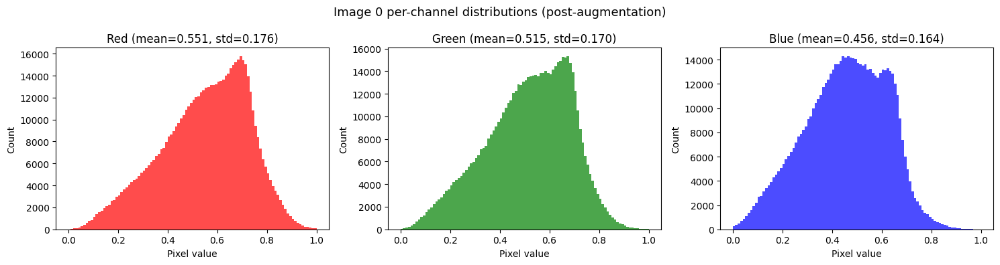

In [15]:
plot_channel_histograms(
    aug_images[0], title="Image 0 per-channel distributions (post-augmentation)"
)

In [16]:
learner = Learner(
    dls=dls,
    model=model,
    loss_func=loss_func,
    metrics=[YOLOmAP50(nc=NUM_CLASSES), RasterIoU(conf_thresh=0.25)],
    cbs=callbacks,
)

In [17]:
if use_bf16:
    learner = learner.to_bf16()

/home/nick/Documents/Work code/SKW_YOLO/.venv/lib/python3.13/site-packages/fastai/callback/core.py:71: UserWarning: You are shadowing an attribute (ema) that exists in the learner. Use `self.learn.ema` to avoid this
  warn(f"You are shadowing an attribute ({name}) that exists in the learner. Use `self.learn.{name}` to avoid this")


epoch,train_loss,valid_loss,mAP50,raster_iou,time
0,125.640511,116.715515,0.000952,0.000000,00:29
1,100.263191,100.261688,0.099129,0.170705,00:30
2,93.406715,88.346298,0.159928,0.341373,00:26
3,91.823410,83.650002,0.128201,0.454299,00:26
4,88.879295,91.871666,0.113940,0.229032,00:17
5,85.897133,84.542755,0.125927,0.356708,00:24
6,85.858154,89.130341,0.127401,0.159613,00:16
7,86.234978,79.778412,0.182393,0.219474,00:24
8,82.688118,77.836784,0.167920,0.415022,00:25
9,83.370766,82.927391,0.130304,0.120673,00:30


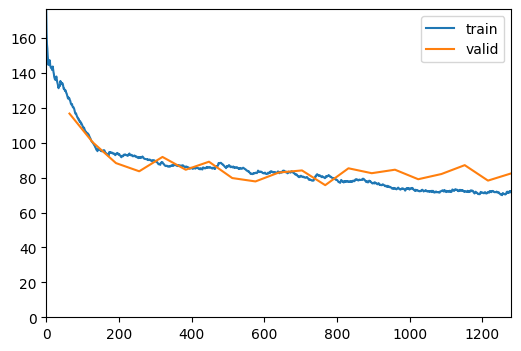

In [18]:
learner.fit_one_cycle(
    n_epoch=epoch_count,
    lr_max=learning_rate,
)

In [19]:
# Save model
model_dir = Path.cwd().parent / "models"
model_dir.mkdir(exist_ok=True)

full_model_name = f"{model_version}_full"
pytorch_model_path = model_dir / f"{model_version}.pth"
state_path = model_dir / f"{model_version}_state.pth"
safetensor_path = model_dir / f"{model_version}_state.safetensors"

# Save fastai learner
learner.save(full_model_name)

# Save PyTorch model
export_model = learner.model.cpu().float()
torch.save(export_model, pytorch_model_path)
torch.save(export_model.state_dict(), state_path)
save_file(export_model.state_dict(), safetensor_path)

print("Saved to:")
print(f"  Learner: {full_model_name}")
print(f"  PyTorch: {pytorch_model_path}")
print(f"  State: {state_path}")
print(f"  Safetensors: {safetensor_path}")

Saved to:
  Learner: SKW_YOLO26_m_full
  PyTorch: /home/nick/Documents/Work code/SKW_YOLO/models/SKW_YOLO26_m.pth
  State: /home/nick/Documents/Work code/SKW_YOLO/models/SKW_YOLO26_m_state.pth
  Safetensors: /home/nick/Documents/Work code/SKW_YOLO/models/SKW_YOLO26_m_state.safetensors


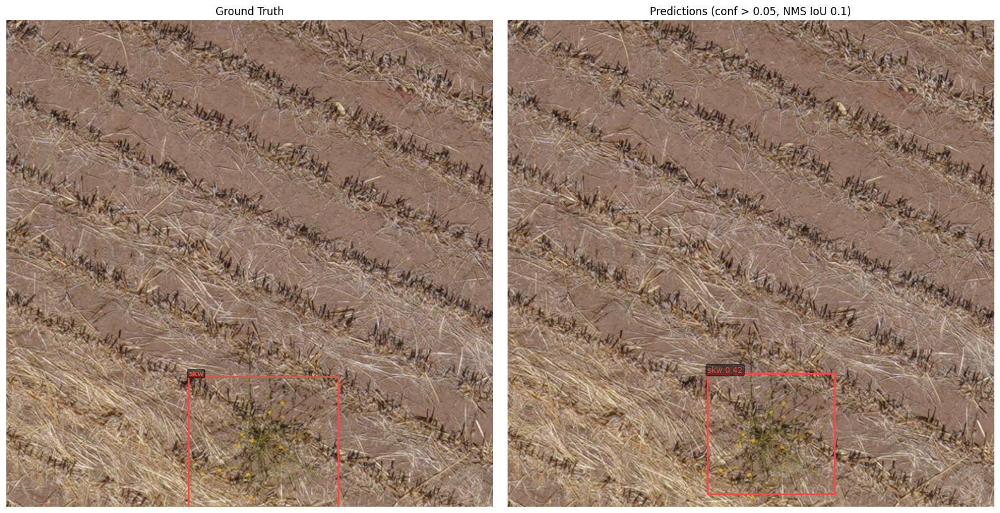

Image 0: 1 GT boxes, 1 predicted boxes


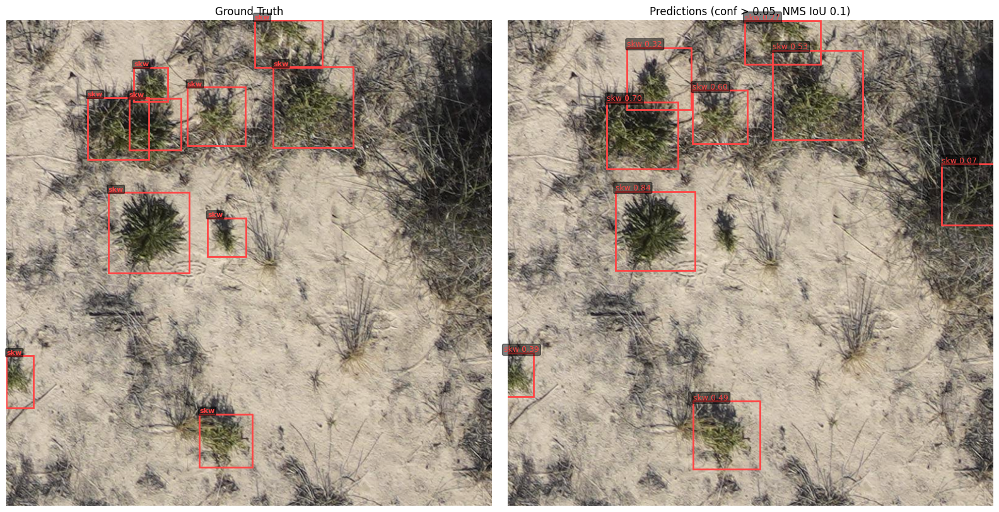

Image 1: 10 GT boxes, 9 predicted boxes


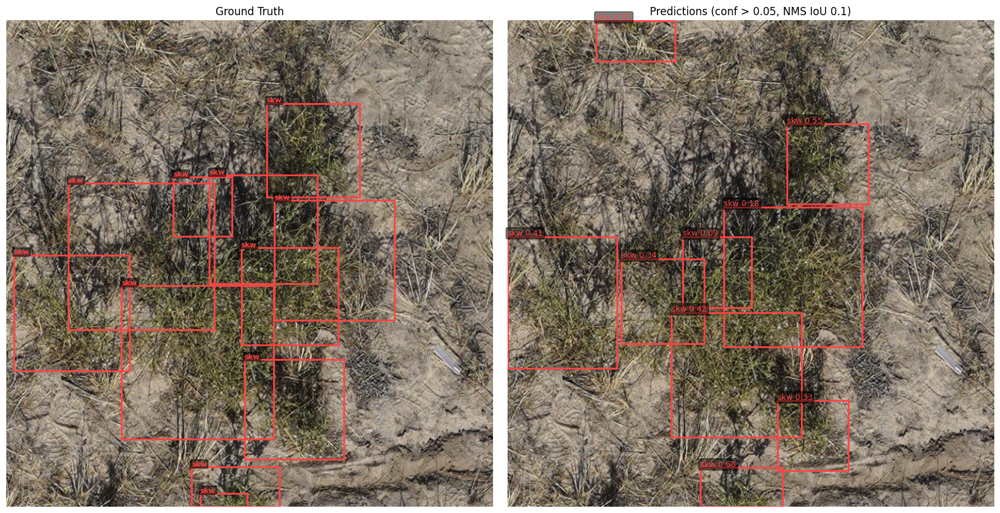

Image 2: 11 GT boxes, 9 predicted boxes


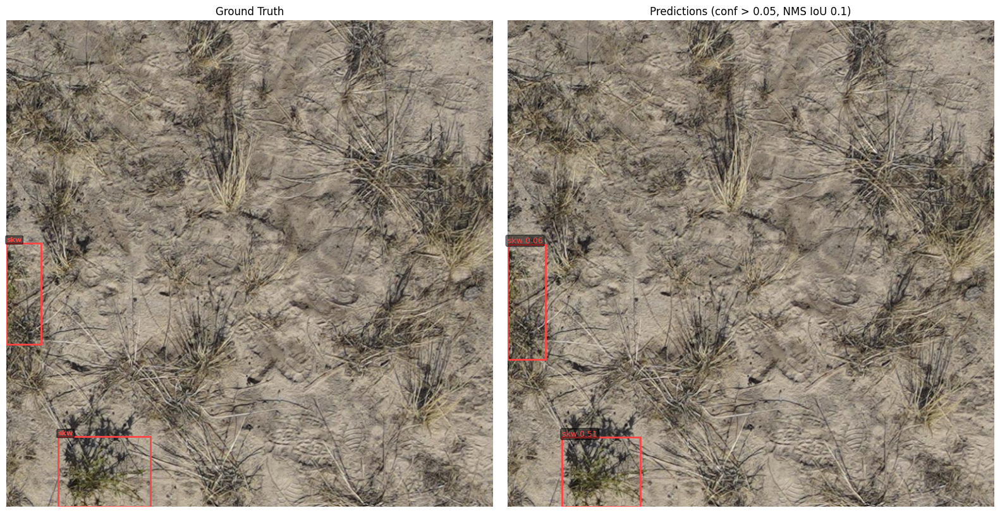

Image 3: 2 GT boxes, 2 predicted boxes


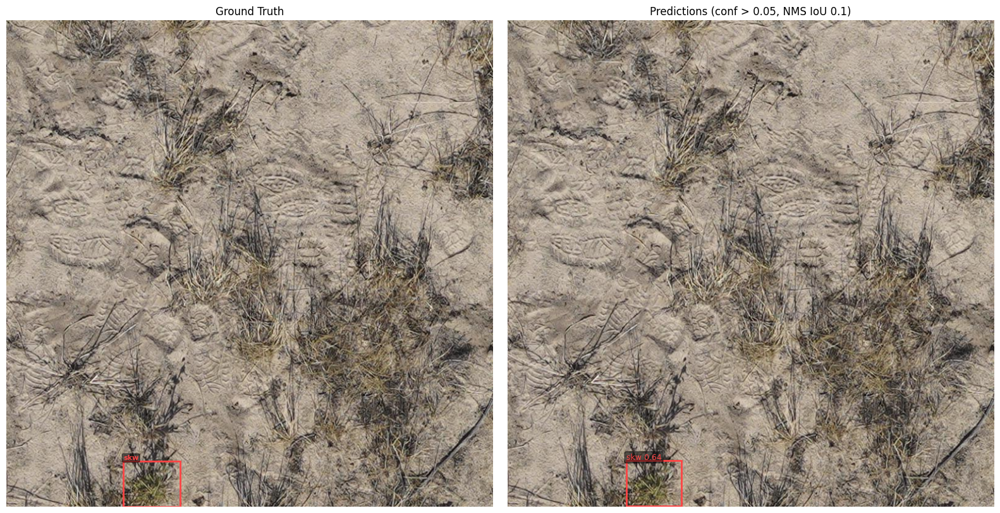

Image 4: 1 GT boxes, 1 predicted boxes


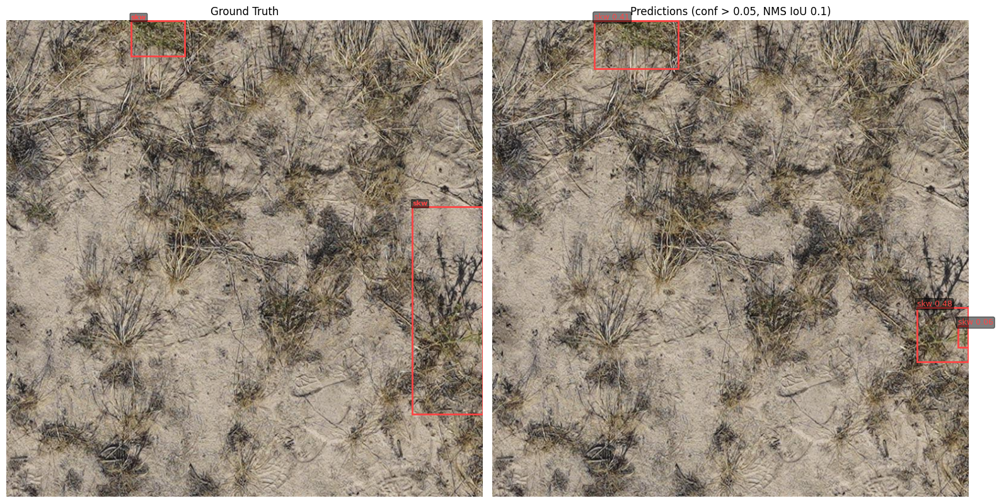

Image 5: 2 GT boxes, 3 predicted boxes


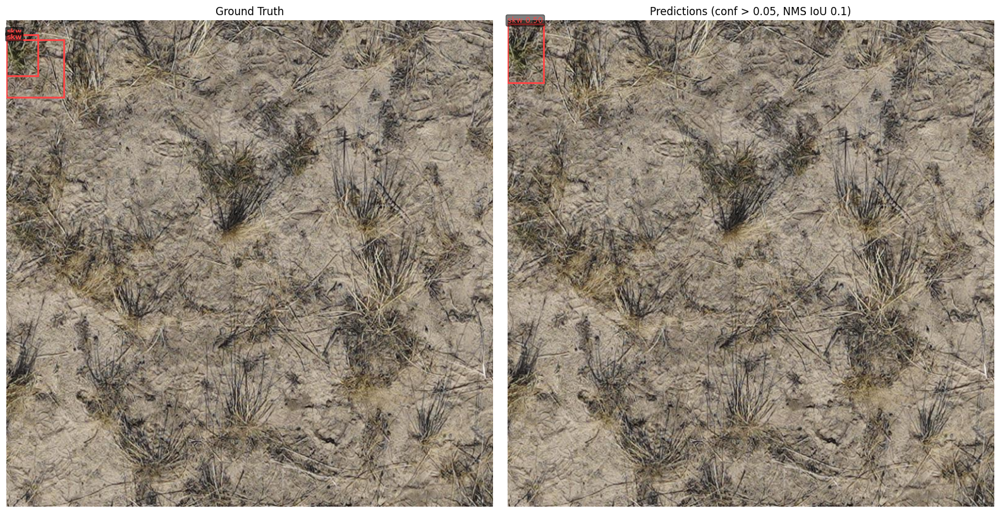

Image 6: 2 GT boxes, 1 predicted boxes


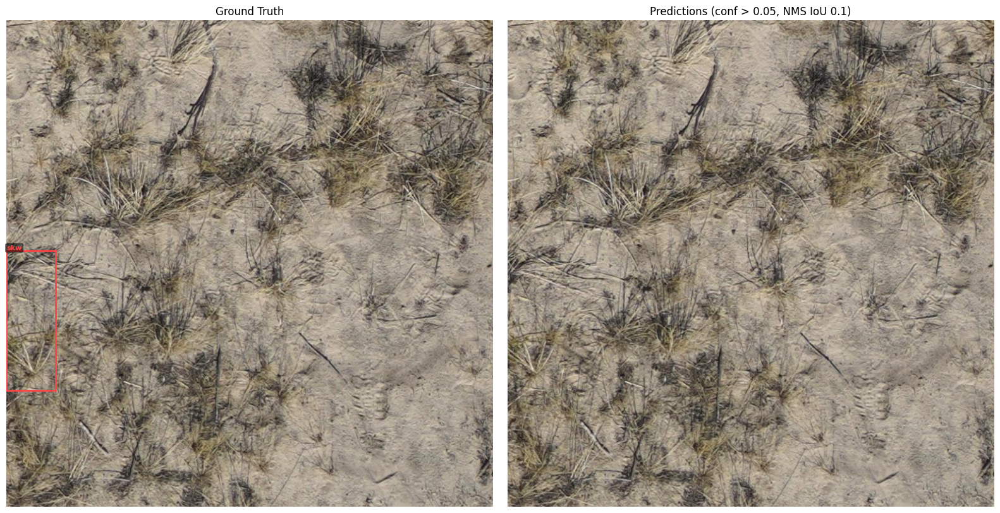

Image 7: 1 GT boxes, 0 predicted boxes


In [20]:
# Visualize predictions on validation images
n_images = 8  # number of images to show
conf_threshold = 0.05  # lower threshold for early training
nms_iou_threshold = 0.1

model = learner.model.cuda().float()
model.eval()

import matplotlib.patches as mpatches
from torchvision.ops import nms

# Collect images across multiple batches
all_images, all_targets_list, all_decoded = [], [], []
val_iter = iter(dls.valid)
while len(all_images) < n_images:
    try:
        images, targets = next(val_iter)
    except StopIteration:
        break
    with torch.no_grad():
        preds = model(images.cuda().float())
        decoded = preds[0].cpu().float()  # [B, 300, 6]
    H, W = images.shape[2], images.shape[3]
    for i in range(images.shape[0]):
        if len(all_images) >= n_images:
            break
        gt_mask = targets["batch_idx"] == i
        all_images.append(images[i])
        all_targets_list.append(
            {
                "boxes": targets["bboxes"][gt_mask].cpu(),
                "cls": targets["cls"][gt_mask].squeeze(-1).cpu(),
            }
        )
        all_decoded.append(decoded[i])

colors = ["#FF4444", "#44FF44"]
for img_idx in range(len(all_images)):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

    img = all_images[img_idx].cpu().float().numpy().transpose(1, 2, 0)
    img = (img - img.min()) / (img.max() - img.min() + 1e-8)
    H, W = all_images[img_idx].shape[1], all_images[img_idx].shape[2]

    # Ground truth (left)
    ax1.imshow(img)
    ax1.set_title("Ground Truth")
    gt_boxes = all_targets_list[img_idx]["boxes"].numpy()
    gt_cls = all_targets_list[img_idx]["cls"].numpy()
    for j in range(len(gt_cls)):
        xc, yc, w, h = gt_boxes[j]
        x1, y1 = (xc - w / 2) * W, (yc - h / 2) * H
        rect = mpatches.Rectangle(
            (x1, y1),
            w * W,
            h * H,
            linewidth=2,
            edgecolor=colors[int(gt_cls[j]) % len(colors)],
            facecolor="none",
        )
        ax1.add_patch(rect)
        ax1.text(
            x1,
            y1 - 2,
            CLASS_NAMES.get(int(gt_cls[j]), str(int(gt_cls[j]))),
            color=colors[int(gt_cls[j]) % len(colors)],
            fontsize=8,
            fontweight="bold",
            bbox=dict(boxstyle="round,pad=0.15", facecolor="black", alpha=0.5),
        )
    ax1.axis("off")

    # Predictions with NMS (right)
    ax2.imshow(img)
    ax2.set_title(f"Predictions (conf > {conf_threshold}, NMS IoU {nms_iou_threshold})")
    det_tensor = all_decoded[img_idx]
    conf_mask = det_tensor[:, 4] > conf_threshold
    det_tensor = det_tensor[conf_mask]

    if len(det_tensor) > 0:
        boxes_xyxy = det_tensor[:, :4]
        scores = det_tensor[:, 4]
        keep = nms(boxes_xyxy, scores, nms_iou_threshold)
        dets = det_tensor[keep].numpy()
    else:
        dets = det_tensor.numpy()

    for det in dets:
        x1, y1, x2, y2, conf, cls_id = det
        color = colors[int(cls_id) % len(colors)]
        rect = mpatches.Rectangle(
            (x1, y1),
            x2 - x1,
            y2 - y1,
            linewidth=2,
            edgecolor=color,
            facecolor="none",
        )
        ax2.add_patch(rect)
        name = CLASS_NAMES.get(int(cls_id), str(int(cls_id)))
        ax2.text(
            x1,
            y1 - 2,
            f"{name} {conf:.2f}",
            color=color,
            fontsize=9,
            bbox=dict(boxstyle="round,pad=0.2", facecolor="black", alpha=0.5),
        )
    ax2.axis("off")

    plt.tight_layout()
    plt.show()
    print(f"Image {img_idx}: {len(gt_cls)} GT boxes, {len(dets)} predicted boxes")